# CitizenScience Challenge: Data Exploration

In [53]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
import geopandas as gpd
import geoplot as gplt
from glob import glob
from pandas_profiling import ProfileReport
import plotly.express as px

### 0. Read Data & Stuff

In [2]:
data_folder = 'muki_data'

In [3]:
for f in glob(data_folder+"/*.csv"):
    print(f)

muki_data/CNC Los Angeles 2020.csv
muki_data/CNC San Francisco 2020.csv
muki_data/CNC San Francisco 2018.csv
muki_data/CNC Los Angeles 2019.csv
muki_data/CNC Los Angeles 2018.csv
muki_data/CNC San Francisco 2019.csv
muki_data/CNC San Francisco 2017.csv
muki_data/CNC Los Angeles 2017.csv
muki_data/CNC London 2020.csv
muki_data/CNC London 2018.csv
muki_data/CNC London 2019.csv


In [4]:
result = pd.concat([pd.read_csv(f).assign(challenge=f.replace(".csv","")) for f in glob(data_folder+"/*.csv")])

/Users/florence/opt/anaconda3/envs/data_analysis/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3337: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [5]:
result.head()

,id,observed_on_string,observed_on,time_observed_at,time_zone,user_id,user_login,created_at,updated_at,quality_grade,...,taxon_geoprivacy,coordinates_obscured,positioning_method,positioning_device,species_guess,scientific_name,common_name,iconic_taxon_name,taxon_id,challenge
0,43036512,Fri Apr 24 2020 00:00:06 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:06 UTC,Pacific Time (US & Canada),907908,samatha,2020-04-24 07:00:14 UTC,2020-04-24 07:03:12 UTC,needs_id,...,NaN,False,NaN,NaN,NaN,Lepidoptera,Butterflies and Moths,Insecta,47157.0,muki_data/CNC Los Angeles 2020
1,43036525,Fri Apr 24 2020 00:00:04 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:04 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:00:26 UTC,2020-04-25 19:04:04 UTC,needs_id,...,NaN,True,NaN,NaN,Butterflies and Moths,Lepidoptera,Butterflies and Moths,Insecta,47157.0,muki_data/CNC Los Angeles 2020
2,43036534,Fri Apr 24 2020 00:00:12 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:12 UTC,Pacific Time (US & Canada),146517,maiz,2020-04-24 07:00:36 UTC,2020-04-26 01:01:54 UTC,needs_id,...,NaN,True,NaN,NaN,Clogmia,Clogmia,NaN,Insecta,247953.0,muki_data/CNC Los Angeles 2020
3,43036755,Fri Apr 24 2020 00:02:36 GMT-0700 (PDT),2020-04-24,2020-04-24 07:02:36 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:03:47 UTC,2020-05-01 07:01:32 UTC,needs_id,...,NaN,True,NaN,NaN,Ground Beetles,Carabidae,Ground Beetles,Insecta,49567.0,muki_data/CNC Los Angeles 2020
4,43036856,Fri Apr 24 2020 00:04:31 GMT-0700 (PDT),2020-04-24,2020-04-24 07:04:31 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:05:04 UTC,2020-04-26 01:06:07 UTC,needs_id,...,NaN,True,NaN,NaN,Beetles,Coleoptera,Beetles,Insecta,47208.0,muki_data/CNC Los Angeles 2020


In [6]:
new_challenge = result.challenge.str.split('/', expand=True)
new_challenge

,0,1
0,muki_data,CNC Los Angeles 2020
1,muki_data,CNC Los Angeles 2020
2,muki_data,CNC Los Angeles 2020
3,muki_data,CNC Los Angeles 2020
4,muki_data,CNC Los Angeles 2020
...,...,...
5340,muki_data,CNC London 2019
5341,muki_data,CNC London 2019
5342,muki_data,CNC London 2019
5343,muki_data,CNC London 2019


In [7]:
new_challenge.rename(columns={0: 'data', 1: 'challenge'}, inplace=True)

In [9]:
result['challenge'] = new_challenge['challenge']

In [11]:
# how much data do we have for each challenge? 
challenge_by_num = result.groupby(['challenge']).count()['id']
challenge_by_num = challenge_by_num.to_frame()
challenge_by_num.head()

,id
challenge,
CNC London 2018,2624
CNC London 2019,5345
CNC London 2020,5761
CNC Los Angeles 2017,18169
CNC Los Angeles 2018,19357


In [12]:
challenge_by_num.reset_index(inplace=True)
challenge_by_num.head()

,challenge,id
0,CNC London 2018,2624
1,CNC London 2019,5345
2,CNC London 2020,5761
3,CNC Los Angeles 2017,18169
4,CNC Los Angeles 2018,19357


In [13]:
test_df = challenge_by_num.challenge.str.split(' ', expand=True)
test_df.head()

,0,1,2,3
0,CNC,London,2018,None
1,CNC,London,2019,None
2,CNC,London,2020,None
3,CNC,Los,Angeles,2017
4,CNC,Los,Angeles,2018


In [14]:
test_df[['city', 'year']] = challenge_by_num.challenge.str.split(' 20', expand=True)

In [15]:
test_df.head()

,0,1,2,3,city,year
0,CNC,London,2018,None,CNC London,18
1,CNC,London,2019,None,CNC London,19
2,CNC,London,2020,None,CNC London,20
3,CNC,Los,Angeles,2017,CNC Los Angeles,17
4,CNC,Los,Angeles,2018,CNC Los Angeles,18


In [16]:
challenge_by_num['city'] = test_df['city']
challenge_by_num['year'] = test_df['year']
challenge_by_num.rename(columns={"id": "num_data"}, inplace=True)
challenge_by_num.head()

,challenge,num_data,city,year
0,CNC London 2018,2624,CNC London,18
1,CNC London 2019,5345,CNC London,19
2,CNC London 2020,5761,CNC London,20
3,CNC Los Angeles 2017,18169,CNC Los Angeles,17
4,CNC Los Angeles 2018,19357,CNC Los Angeles,18


In [17]:
challenge_by_num[['cnc', 'city2']] = challenge_by_num.city.str.split('CNC ', expand=True)
challenge_by_num.drop(columns=['city', 'cnc', 'challenge'], inplace=True)
challenge_by_num.head()

,num_data,year,city2
0,2624,18,London
1,5345,19,London
2,5761,20,London
3,18169,17,Los Angeles
4,19357,18,Los Angeles


In [18]:
challenge_by_num.year = pd.to_numeric(challenge_by_num.year)
challenge_by_num.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11 entries, 0 to 10
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   num_data  11 non-null     int64 
 1   year      11 non-null     int64 
 2   city2     11 non-null     object
dtypes: int64(2), object(1)
memory usage: 392.0+ bytes


#### plot number of data points per year and city

In [19]:
sns.set_theme()

<AxesSubplot:xlabel='year', ylabel='num_data'>

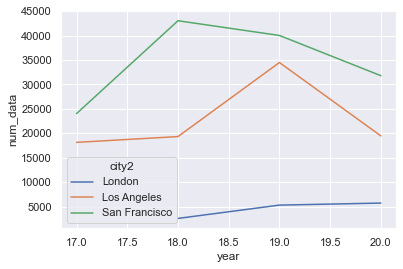

In [20]:
sns.lineplot(data=challenge_by_num, x="year", y="num_data", hue='city2')

### Q1: How many different users do we have per year and per city? (This could quantify participation)

In [21]:
result[['city', 'year']] = result.challenge.str.split(' 20', expand=True)

In [23]:
result.head()

,id,observed_on_string,observed_on,time_observed_at,time_zone,user_id,user_login,created_at,updated_at,quality_grade,...,positioning_method,positioning_device,species_guess,scientific_name,common_name,iconic_taxon_name,taxon_id,challenge,city,year
0,43036512,Fri Apr 24 2020 00:00:06 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:06 UTC,Pacific Time (US & Canada),907908,samatha,2020-04-24 07:00:14 UTC,2020-04-24 07:03:12 UTC,needs_id,...,NaN,NaN,NaN,Lepidoptera,Butterflies and Moths,Insecta,47157.0,CNC Los Angeles 2020,CNC Los Angeles,20
1,43036525,Fri Apr 24 2020 00:00:04 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:04 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:00:26 UTC,2020-04-25 19:04:04 UTC,needs_id,...,NaN,NaN,Butterflies and Moths,Lepidoptera,Butterflies and Moths,Insecta,47157.0,CNC Los Angeles 2020,CNC Los Angeles,20
2,43036534,Fri Apr 24 2020 00:00:12 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:12 UTC,Pacific Time (US & Canada),146517,maiz,2020-04-24 07:00:36 UTC,2020-04-26 01:01:54 UTC,needs_id,...,NaN,NaN,Clogmia,Clogmia,NaN,Insecta,247953.0,CNC Los Angeles 2020,CNC Los Angeles,20
3,43036755,Fri Apr 24 2020 00:02:36 GMT-0700 (PDT),2020-04-24,2020-04-24 07:02:36 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:03:47 UTC,2020-05-01 07:01:32 UTC,needs_id,...,NaN,NaN,Ground Beetles,Carabidae,Ground Beetles,Insecta,49567.0,CNC Los Angeles 2020,CNC Los Angeles,20
4,43036856,Fri Apr 24 2020 00:04:31 GMT-0700 (PDT),2020-04-24,2020-04-24 07:04:31 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:05:04 UTC,2020-04-26 01:06:07 UTC,needs_id,...,NaN,NaN,Beetles,Coleoptera,Beetles,Insecta,47208.0,CNC Los Angeles 2020,CNC Los Angeles,20


In [24]:
result[['cnc', 'city2']] = result.city.str.split('CNC ', expand=True)

In [25]:
result.head()

,id,observed_on_string,observed_on,time_observed_at,time_zone,user_id,user_login,created_at,updated_at,quality_grade,...,species_guess,scientific_name,common_name,iconic_taxon_name,taxon_id,challenge,city,year,cnc,city2
0,43036512,Fri Apr 24 2020 00:00:06 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:06 UTC,Pacific Time (US & Canada),907908,samatha,2020-04-24 07:00:14 UTC,2020-04-24 07:03:12 UTC,needs_id,...,NaN,Lepidoptera,Butterflies and Moths,Insecta,47157.0,CNC Los Angeles 2020,CNC Los Angeles,20,,Los Angeles
1,43036525,Fri Apr 24 2020 00:00:04 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:04 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:00:26 UTC,2020-04-25 19:04:04 UTC,needs_id,...,Butterflies and Moths,Lepidoptera,Butterflies and Moths,Insecta,47157.0,CNC Los Angeles 2020,CNC Los Angeles,20,,Los Angeles
2,43036534,Fri Apr 24 2020 00:00:12 GMT-0700 (PDT),2020-04-24,2020-04-24 07:00:12 UTC,Pacific Time (US & Canada),146517,maiz,2020-04-24 07:00:36 UTC,2020-04-26 01:01:54 UTC,needs_id,...,Clogmia,Clogmia,NaN,Insecta,247953.0,CNC Los Angeles 2020,CNC Los Angeles,20,,Los Angeles
3,43036755,Fri Apr 24 2020 00:02:36 GMT-0700 (PDT),2020-04-24,2020-04-24 07:02:36 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:03:47 UTC,2020-05-01 07:01:32 UTC,needs_id,...,Ground Beetles,Carabidae,Ground Beetles,Insecta,49567.0,CNC Los Angeles 2020,CNC Los Angeles,20,,Los Angeles
4,43036856,Fri Apr 24 2020 00:04:31 GMT-0700 (PDT),2020-04-24,2020-04-24 07:04:31 UTC,Pacific Time (US & Canada),2556338,charlesjaeckerjones,2020-04-24 07:05:04 UTC,2020-04-26 01:06:07 UTC,needs_id,...,Beetles,Coleoptera,Beetles,Insecta,47208.0,CNC Los Angeles 2020,CNC Los Angeles,20,,Los Angeles


In [26]:
result.drop(columns=['city', 'cnc'], inplace=True)
result.rename(columns={"city2": "challenge_city", 'year':'challenge_year'}, inplace=True)

In [28]:
users_per_challenge = result.groupby(['challenge_year', 'challenge_city'])['user_id'].nunique()
users_per_challenge = users_per_challenge.to_frame()
users_per_challenge.head()

user_id
challenge_year challenge_city         
17             Los Angeles         892
               San Francisco       779
18             London              109
               Los Angeles         887
               San Francisco      1747

<AxesSubplot:xlabel='challenge_year'>

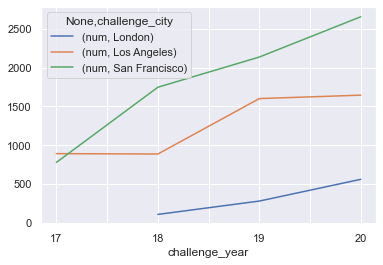

In [29]:
users_per_challenge.rename(columns={'user_id':'num'}, inplace=True)
users_per_challenge.unstack().plot()

The number of unique users is strongly increasing over time for London and San Francisco and very slightly increasing for Los Angeles.

### Q2: how is the quality changing over time?

In [30]:
result.quality_grade.unique()

array(['needs_id', 'research', 'casual'], dtype=object)

In [31]:
quality_per_year = result.groupby(['challenge_year', 'quality_grade'])['id'].count()
quality_per_year = quality_per_year.to_frame()
quality_per_year.head()

id
challenge_year quality_grade       
17             casual          5409
               needs_id       14018
               research       22793
18             casual          6615
               needs_id       22338

In [32]:
quality_per_year.rename(columns={'id':'num'}, inplace=True)

#### plot the results for every year at once.

<AxesSubplot:xlabel='challenge_year'>

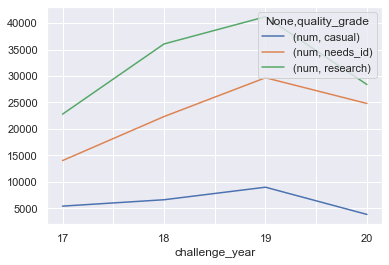

In [33]:
quality_per_year.unstack().plot()

As we can see, more data is in research quality than in casual quality. We can also see that the number of qualities increases until 2019 and then decreases, which is the same pattern that we can observe for all data points per year.

### Q3: how is quality distributed over the different cities for all years at once?

In [34]:
quality_per_city = result.groupby(['challenge_city', 'quality_grade'])['id'].count()
quality_per_city = quality_per_city.to_frame()
quality_per_city.rename(columns={'id':'num'}, inplace=True)
quality_per_city.head()

num
challenge_city quality_grade       
London         casual          1802
               needs_id        5574
               research        6354
Los Angeles    casual         14468
               needs_id       33416

<AxesSubplot:xlabel='challenge_city'>

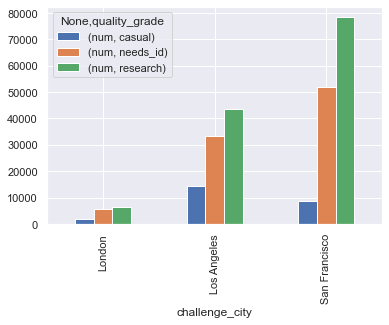

In [35]:
quality_per_city.unstack().plot(kind='bar')

### A1: Geoplotting Stuff

In [36]:
# drop nans in longitude and latitude columns 
nan_index_long = result['longitude'].index[result['longitude'].apply(np.isnan)]
nan_index_lat = result['latitude'].index[result['latitude'].apply(np.isnan)]

In [37]:
# check if both are the same: 
np.unique(nan_index_lat == nan_index_long)

array([ True])

In [38]:
# both are the same, so delete all rows with nan in result dataframe
print(result.shape)
result.drop(nan_index_lat, inplace=True)
print(result.shape)

(244148, 37)
(240069, 37)


In [39]:
# create geometry points from longitude and latitude columns 
gdf = gpd.GeoDataFrame(result, geometry=gpd.points_from_xy(result.longitude, result.latitude))

In [40]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

<AxesSubplot:>

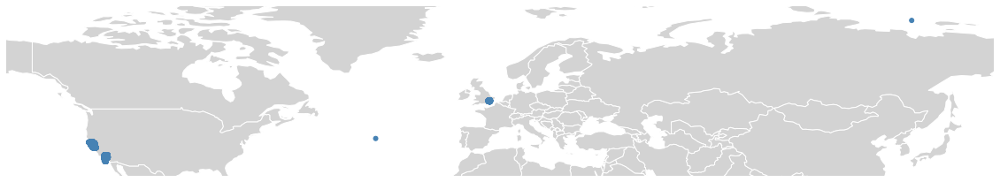

In [41]:
# plot the locations on the world map 
ax = gplt.polyplot(
  world,
  edgecolor="white",
  facecolor="lightgray",
  figsize=(20, 20),
)

gplt.pointplot(
  gdf,
  ax=ax
)

Since the challenges took only part in LA, SF and London, the majority of regions are also in LA, SF and London.  
Maybe the two outlier points should be deleted.

### A2: Pandas-Profiling

In [42]:
# drop geometry column, since this won't work with pandas-profiling
new_result = result.drop(columns=['geometry'])

In [43]:
profile = ProfileReport(new_result, title="Pandas Profiling Report")

In [99]:
profile

### Q4: when were the most data points observed for each year?

In [46]:
time_per_challenge = result.groupby(['observed_on', 'challenge_year'])['id'].count()
time_per_challenge = time_per_challenge.to_frame()
time_per_challenge.rename(columns={'id':'num'}, inplace=True)
time_per_challenge.reset_index(inplace=True)
time_per_challenge.set_index('observed_on', inplace=True)
time_per_challenge.head()

,challenge_year,num
observed_on,,
2016-04-15,17,1
2017-04-01,17,6
2017-04-13,17,5
2017-04-14,17,8796
2017-04-15,17,11915


<AxesSubplot:xlabel='observed_on'>

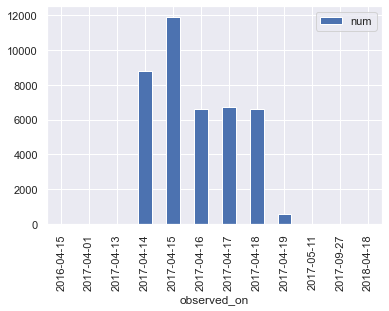

In [47]:
#for the year 2017
time_per_challenge[time_per_challenge.challenge_year == '17'].plot(kind='bar')

<AxesSubplot:xlabel='observed_on'>

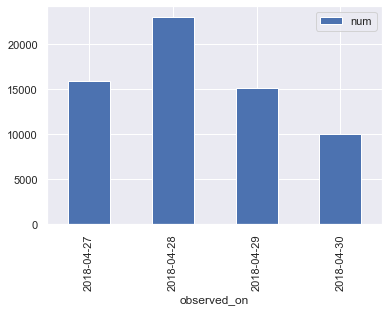

In [48]:
time_per_challenge[time_per_challenge.challenge_year == '18'].plot(kind='bar')

<AxesSubplot:xlabel='observed_on'>

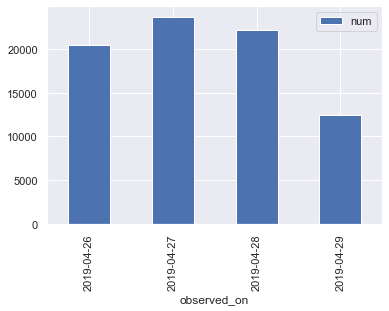

In [49]:
time_per_challenge[time_per_challenge.challenge_year == '19'].plot(kind='bar')

<AxesSubplot:xlabel='observed_on'>

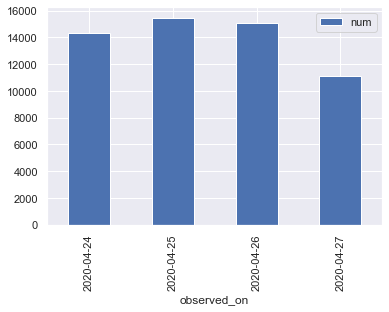

In [50]:
time_per_challenge[time_per_challenge.challenge_year == '20'].plot(kind='bar')

### Q5: when were the most data points observed for each year and each city?

In [51]:
time_per_city = result.groupby(['observed_on', 'challenge_year', 'challenge_city'])['id'].count()
time_per_city = time_per_city.to_frame()
time_per_city.rename(columns={'id':'num'}, inplace=True)
time_per_city.reset_index(inplace=True)
time_per_city.head()

,observed_on,challenge_year,challenge_city,num
0,2016-04-15,17,Los Angeles,1
1,2017-04-01,17,San Francisco,6
2,2017-04-13,17,San Francisco,5
3,2017-04-14,17,Los Angeles,3357
4,2017-04-14,17,San Francisco,5439


In [52]:
time_per_city.observed_on.unique()

array(['2016-04-15', '2017-04-01', '2017-04-13', '2017-04-14',
       '2017-04-15', '2017-04-16', '2017-04-17', '2017-04-18',
       '2017-04-19', '2017-05-11', '2017-09-27', '2018-04-18',
       '2018-04-27', '2018-04-28', '2018-04-29', '2018-04-30',
       '2019-04-26', '2019-04-27', '2019-04-28', '2019-04-29',
       '2020-04-24', '2020-04-25', '2020-04-26', '2020-04-27'],
      dtype=object)

In [54]:
# drop rows with single observations
drop_idxs = time_per_city[time_per_city.num == 1].index.values

In [55]:
time_per_city.drop(time_per_city.index[drop_idxs], inplace=True)

In [56]:
time17 = time_per_city[time_per_city.challenge_year=='17']

In [57]:
time17.observed_on.min()

'2017-04-01'

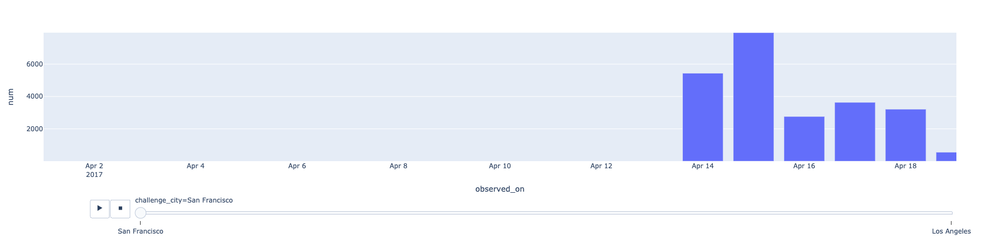

In [58]:
fig = px.bar(time17, x='observed_on', y='num', animation_frame="challenge_city", range_y=[time17.num.min(), time17.num.max()], range_x=[time17.observed_on.min(), time17.observed_on.max()])
fig.show()

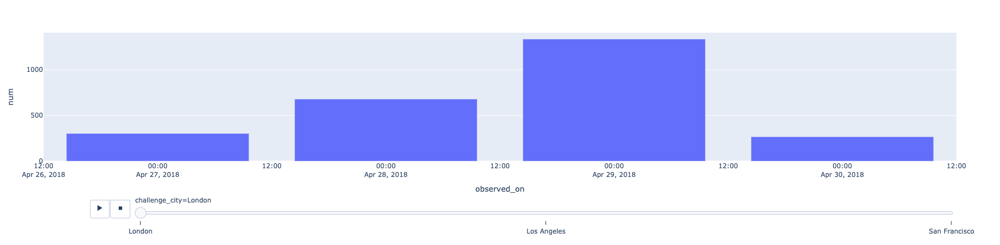

In [59]:
time18 = time_per_city[time_per_city.challenge_year=='18']
fig = px.bar(time18, x='observed_on', y='num', animation_frame="challenge_city")
fig.show()

### A3: Scatter-Mapbox divided by the three challenges

In [60]:
challenge_SF = result[result.challenge_city == 'San Francisco']
challenge_LA = result[result.challenge_city == 'Los Angeles']
challenge_LD = result[result.challenge_city == 'London']

From the map we can see that there is an outlier in the sea, which does not make any sense. The ID of it is 5729182 and it will be removed. 

In [61]:
drop_idx = result[result.id == 5729182].index.values

In [62]:
drop_idx

array([4462])

In [63]:
result.drop(4462, inplace=True)

#### plot observations on map for SF for all years, coloured in the quality grade they had:

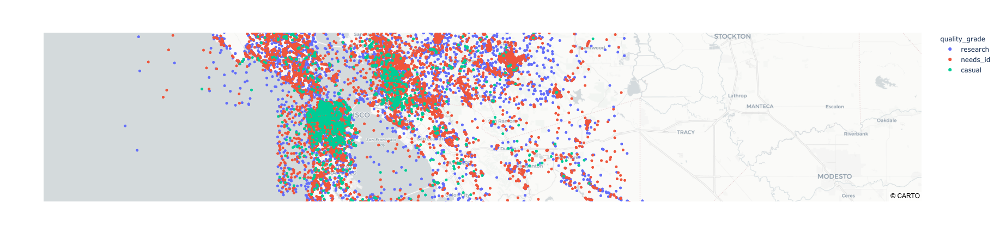

In [143]:
fig = px.scatter_mapbox(challenge_SF, lat="latitude", lon="longitude", color="quality_grade",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

#### plot observations on map for LA for all years, coloured in the quality grade they had:

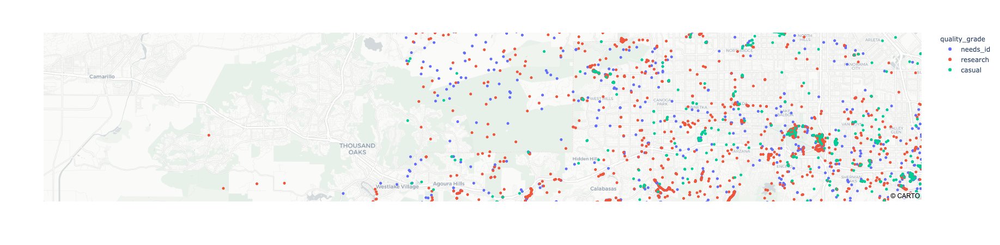

In [144]:
challenge_LA = result[result.challenge_city == 'Los Angeles']
fig = px.scatter_mapbox(challenge_LA, lat="latitude", lon="longitude", color="quality_grade",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

#### plot observations on map for London for all years, coloured in the quality grade they had:

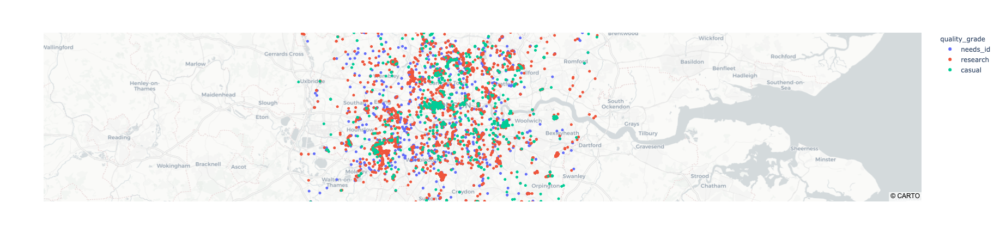

In [146]:
challenge_LD = result[result.challenge_city == 'London']
fig = px.scatter_mapbox(challenge_LD, lat="latitude", lon="longitude", color="quality_grade",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

### A4: Scatter-Mapbox divided by the three challenges and grouped by users

In [64]:
grouped_users_SF = challenge_SF.groupby('user_id').quality_grade.count()
grouped_users_SF = grouped_users_SF.to_frame()
grouped_users_SF.reset_index(inplace=True)
grouped_users_SF.head()

,user_id,quality_grade
0,1,782
1,5,7
2,17,29
3,28,886
4,181,97


In [65]:
user_longs = challenge_SF.groupby('user_id').longitude.mean()
user_lats = challenge_SF.groupby('user_id').latitude.mean()

In [66]:
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()

In [67]:
grouped_users_SF.set_index('user_id', inplace=True)
grouped_users_SF['longitude'] = user_longs['longitude']
grouped_users_SF['latitude'] = user_lats['latitude']
grouped_users_SF.head()

,quality_grade,longitude,latitude
user_id,,,
1,782,-121.983107,37.556359
5,7,-122.273113,37.873557
17,29,-122.476107,38.415928
28,886,-122.040806,37.841980
181,97,-122.298378,37.806989


In [68]:
grouped_users_SF.reset_index(inplace=True)

#### plot the locations of the users and the amount of observations they contributed for all challenge years:

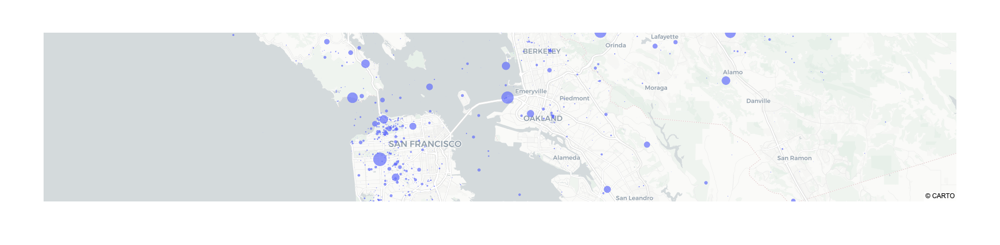

In [73]:
fig = px.scatter_mapbox(grouped_users_SF, lat="latitude", lon="longitude", hover_name='user_id', size='quality_grade', zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [74]:
grouped_users_LA = challenge_LA.groupby('user_id').quality_grade.count()
grouped_users_LA = grouped_users_LA.to_frame()
grouped_users_LA.reset_index(inplace=True)
grouped_users_LA.head()

,user_id,quality_grade
0,382,9
1,1850,1433
2,2179,396
3,2340,26
4,2822,2


In [75]:
user_longs = challenge_LA.groupby('user_id').longitude.mean()
user_lats = challenge_LA.groupby('user_id').latitude.mean()
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()
grouped_users_LA.set_index('user_id', inplace=True)
grouped_users_LA['longitude'] = user_longs['longitude']
grouped_users_LA['latitude'] = user_lats['latitude']
grouped_users_LA.head()

,quality_grade,longitude,latitude
user_id,,,
382,9,-118.677989,34.038529
1850,1433,-118.351730,34.145794
2179,396,-118.525152,34.037652
2340,26,-118.220777,34.143160
2822,2,-118.209800,34.201266


#### plot the locations of the users and the amount of observations they contributed for all challenge years:

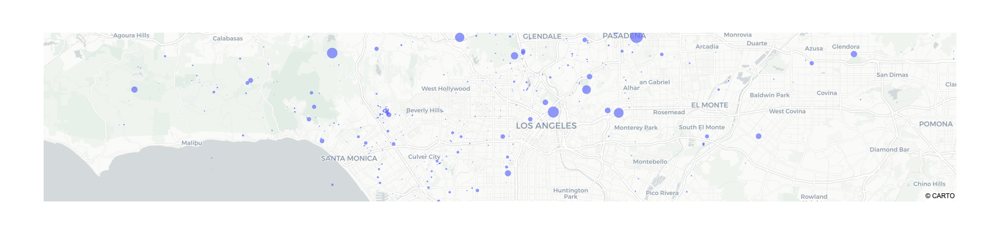

In [76]:
grouped_users_LA.reset_index(inplace=True)
fig = px.scatter_mapbox(grouped_users_LA, lat="latitude", lon="longitude", size='quality_grade', zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [77]:
grouped_users_LD = challenge_LD.groupby('user_id').quality_grade.count()
grouped_users_LD = grouped_users_LD.to_frame()
grouped_users_LD.reset_index(inplace=True)
grouped_users_LD.head()

,user_id,quality_grade
0,484,15
1,1245,2
2,1439,2
3,2111,2
4,13244,3


In [78]:
user_longs = challenge_LD.groupby('user_id').longitude.mean()
user_lats = challenge_LD.groupby('user_id').latitude.mean()
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()
grouped_users_LD.set_index('user_id', inplace=True)
grouped_users_LD['longitude'] = user_longs['longitude']
grouped_users_LD['latitude'] = user_lats['latitude']
grouped_users_LD.head()

,quality_grade,longitude,latitude
user_id,,,
484,15,-0.307349,51.428710
1245,2,-0.273500,51.484602
1439,2,-0.104861,51.575417
2111,2,0.042215,51.663882
13244,3,-0.193555,51.512921


#### plot the locations of the users and the amount of observations they contributed for all challenge years:

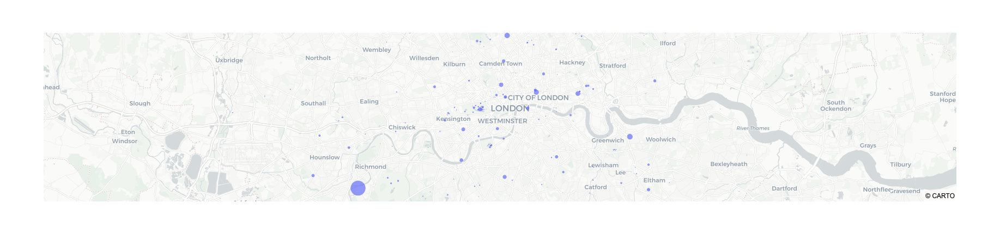

In [79]:
grouped_users_LD.reset_index(inplace=True)
fig = px.scatter_mapbox(grouped_users_LD, lat="latitude", lon="longitude", size='quality_grade', zoom=10,
                  mapbox_style="carto-positron")
fig.show()

### A5: do the above analysis but by year

In [80]:
grouped_users_LD = challenge_LD.groupby(['user_id', 'challenge_year']).quality_grade.count()
grouped_users_LD = grouped_users_LD.to_frame()
grouped_users_LD.reset_index(inplace=True)
grouped_users_LD.head()

,user_id,challenge_year,quality_grade
0,484,18,15
1,1245,20,2
2,1439,20,2
3,2111,18,2
4,13244,19,3


In [81]:
user_longs = challenge_LD.groupby('user_id').longitude.mean()
user_lats = challenge_LD.groupby('user_id').latitude.mean()
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()
grouped_users_LD.set_index('user_id', inplace=True)
grouped_users_LD['longitude'] = user_longs['longitude']
grouped_users_LD['latitude'] = user_lats['latitude']
grouped_users_LD.head()

,challenge_year,quality_grade,longitude,latitude
user_id,,,,
484,18,15,-0.307349,51.428710
1245,20,2,-0.273500,51.484602
1439,20,2,-0.104861,51.575417
2111,18,2,0.042215,51.663882
13244,19,3,-0.193555,51.512921


In [82]:
grouped_users_LD.challenge_year = pd.to_numeric(grouped_users_LD.challenge_year)

In [83]:
grouped_users_LD.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 944 entries, 484 to 3110080
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   challenge_year  944 non-null    int64  
 1   quality_grade   944 non-null    int64  
 2   longitude       944 non-null    float64
 3   latitude        944 non-null    float64
dtypes: float64(2), int64(2)
memory usage: 36.9 KB


In [85]:
grouped_users_LD.sort_values(by=['challenge_year'], inplace=True)
grouped_users_LD.reset_index(inplace=True)

#### plot the locations of the users and the amount of observations they contributed grouped by year (see slider):

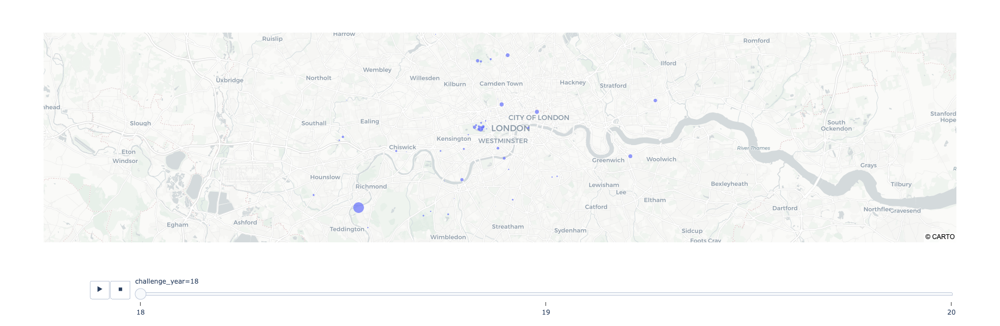

In [86]:
fig = px.scatter_mapbox(grouped_users_LD, lat="latitude", lon="longitude", size='quality_grade', zoom=10,
                  mapbox_style="carto-positron", animation_frame='challenge_year', height=600, hover_name='user_id')
fig.show()

In [87]:
grouped_users_LA = challenge_LA.groupby(['user_id', 'challenge_year']).quality_grade.count()
grouped_users_LA = grouped_users_LA.to_frame()
grouped_users_LA.reset_index(inplace=True)
grouped_users_LA.head()

,user_id,challenge_year,quality_grade
0,382,18,9
1,1850,17,533
2,1850,18,372
3,1850,19,395
4,1850,20,133


In [88]:
user_longs = challenge_LA.groupby('user_id').longitude.mean()
user_lats = challenge_LA.groupby('user_id').latitude.mean()
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()
grouped_users_LA.set_index('user_id', inplace=True)
grouped_users_LA['longitude'] = user_longs['longitude']
grouped_users_LA['latitude'] = user_lats['latitude']
grouped_users_LA.head()

,challenge_year,quality_grade,longitude,latitude
user_id,,,,
382,18,9,-118.677989,34.038529
1850,17,533,-118.351730,34.145794
1850,18,372,-118.351730,34.145794
1850,19,395,-118.351730,34.145794
1850,20,133,-118.351730,34.145794


In [89]:
grouped_users_LA.challenge_year = pd.to_numeric(grouped_users_LA.challenge_year)
grouped_users_LA.sort_values(by=['challenge_year'], inplace=True)
grouped_users_LA.reset_index(inplace=True)

#### plot the locations of the users and the amount of observations they contributed grouped by year (see slider):

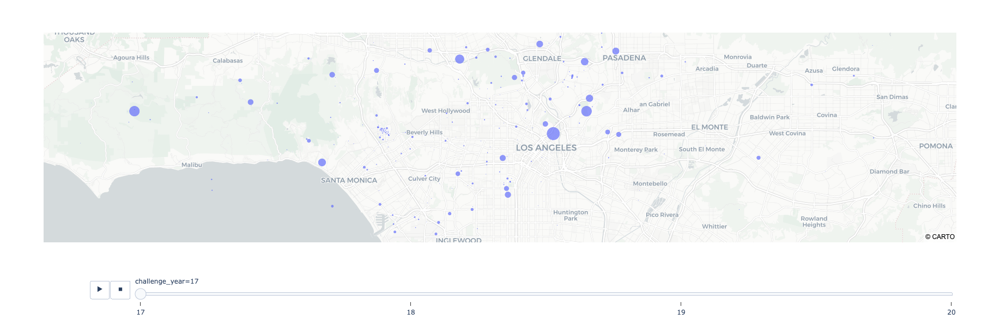

In [90]:
fig = px.scatter_mapbox(grouped_users_LA, lat="latitude", lon="longitude", size='quality_grade', height=600, zoom=10, mapbox_style="carto-positron", animation_frame='challenge_year', hover_name='user_id')
fig.show()

In [91]:
grouped_users_SF = challenge_SF.groupby(['user_id', 'challenge_year']).quality_grade.count()
grouped_users_SF = grouped_users_SF.to_frame()
grouped_users_SF.reset_index(inplace=True)
grouped_users_SF.head()

,user_id,challenge_year,quality_grade
0,1,17,315
1,1,18,167
2,1,19,164
3,1,20,136
4,5,18,7


In [92]:
user_longs = challenge_SF.groupby('user_id').longitude.mean()
user_lats = challenge_SF.groupby('user_id').latitude.mean()
user_longs = user_longs.to_frame()
user_lats = user_lats.to_frame()
grouped_users_SF.set_index('user_id', inplace=True)
grouped_users_SF['longitude'] = user_longs['longitude']
grouped_users_SF['latitude'] = user_lats['latitude']
grouped_users_SF.head()

,challenge_year,quality_grade,longitude,latitude
user_id,,,,
1,17,315,-121.983107,37.556359
1,18,167,-121.983107,37.556359
1,19,164,-121.983107,37.556359
1,20,136,-121.983107,37.556359
5,18,7,-122.273113,37.873557


#### plot the locations of the users and the amount of observations they contributed grouped by year (see slider):

In [94]:
grouped_users_SF.challenge_year = pd.to_numeric(grouped_users_SF.challenge_year)
grouped_users_SF.sort_values(by=['challenge_year'], inplace=True)
grouped_users_SF.reset_index(inplace=True)

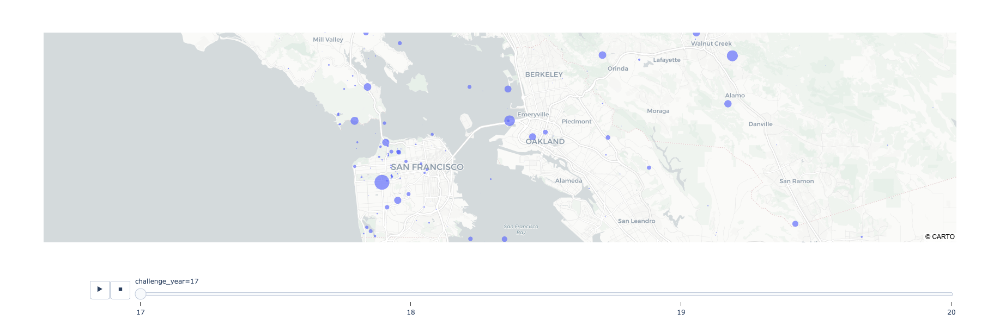

In [95]:
fig = px.scatter_mapbox(grouped_users_SF, lat="latitude", lon="longitude", size='quality_grade',height=600, zoom=10,
                  mapbox_style="carto-positron", animation_frame='challenge_year', hover_name='user_id')
fig.show()